In [2]:
# Core
import pandas as pd
import numpy as np
import os
import datetime
import matplotlib.pyplot as plt

# Frequency Analysis
from scipy.signal import welch
from scipy.signal.windows import hamming

# Primitives
_DATA_DIR = 'data/'
_EEG_CSV = 'eeg.csv'
_BLINK_CSV = 'blink.csv'

In [4]:
# Convert a timestamp to unix seconds
def timestamp_to_unix_seconds(x):
    date_format = datetime.datetime.strptime(x, "%Y-%m-%d %H:%M:%S.%f")
    unix_seconds = datetime.datetime.timestamp(date_format)
    return unix_seconds

# Convert a timestamp to unix milliseconds
def timestamp_to_unix_milliseconds(x):
    unix_seconds = timestamp_to_unix_seconds(x)
    unix_milliseconds = int(unix_seconds * 1000)
    return unix_milliseconds

In [5]:
blink_df = pd.read_csv(os.path.join(_DATA_DIR, _BLINK_CSV))
blink_df['TimeStamp'] = blink_df['unix_ms'].apply(lambda x: datetime.datetime.fromtimestamp(x/1000))
blink_df["unix_ms"] = pd.to_numeric(blink_df["unix_ms"])
blink_df

,unix_ms,frame,rel_timestamp,event,overlap_counter,TimeStamp
0,1758146961975,1,0.000000,Start,0,2025-09-17 18:09:21.975
1,1758146968549,4228,6.542058,Overlap,1,2025-09-17 18:09:28.549
2,1758146970750,5913,8.743770,Overlap,2,2025-09-17 18:09:30.750
3,1758146972952,7602,10.945460,Overlap,3,2025-09-17 18:09:32.952
4,1758146975155,9219,13.148070,Overlap,4,2025-09-17 18:09:35.155
5,1758146979155,12277,17.148360,End,4,2025-09-17 18:09:39.155


In [6]:
eeg_df = pd.read_csv(os.path.join(_DATA_DIR, _EEG_CSV))
eeg_df['unix_ms'] = eeg_df['TimeStamp'].apply(timestamp_to_unix_milliseconds)
eeg_blinks = eeg_df[eeg_df['Elements']=='/muse/elements/blink']
eeg_raw = eeg_df[eeg_df['Elements'].isna()]
eeg_raw.head(5)

,TimeStamp,Delta_TP9,Delta_AF7,Delta_AF8,Delta_TP10,Theta_TP9,Theta_AF7,Theta_AF8,Theta_TP10,Alpha_TP9,...,PPG_Red,Heart_Rate,HeadBandOn,HSI_TP9,HSI_AF7,HSI_AF8,HSI_TP10,Battery,Elements,unix_ms
1,2025-09-17 18:09:20.702,0.384836,0.0,0.192297,1.240292,0.250099,0.0,-0.043874,0.626346,-0.012604,...,2.345055e+06,79.35718,1.0,1.0,1.0,1.0,1.0,85.0,NaN,1758146960702
2,2025-09-17 18:09:20.702,0.384836,0.0,0.192297,1.240292,0.250099,0.0,-0.043874,0.626346,-0.012604,...,2.345055e+06,79.35718,1.0,1.0,1.0,1.0,1.0,85.0,NaN,1758146960702
3,2025-09-17 18:09:20.703,0.384836,0.0,0.192297,1.240292,0.250099,0.0,-0.043874,0.626346,-0.012604,...,2.345055e+06,79.35718,1.0,1.0,1.0,1.0,1.0,85.0,NaN,1758146960703
4,2025-09-17 18:09:20.704,0.384836,0.0,0.192297,1.240292,0.250099,0.0,-0.043874,0.626346,-0.012604,...,2.345055e+06,79.35718,1.0,1.0,1.0,1.0,1.0,85.0,NaN,1758146960704
5,2025-09-17 18:09:20.704,0.384836,0.0,0.192297,1.240292,0.250099,0.0,-0.043874,0.626346,-0.012604,...,2.345055e+06,79.35718,1.0,1.0,1.0,1.0,1.0,85.0,NaN,1758146960704


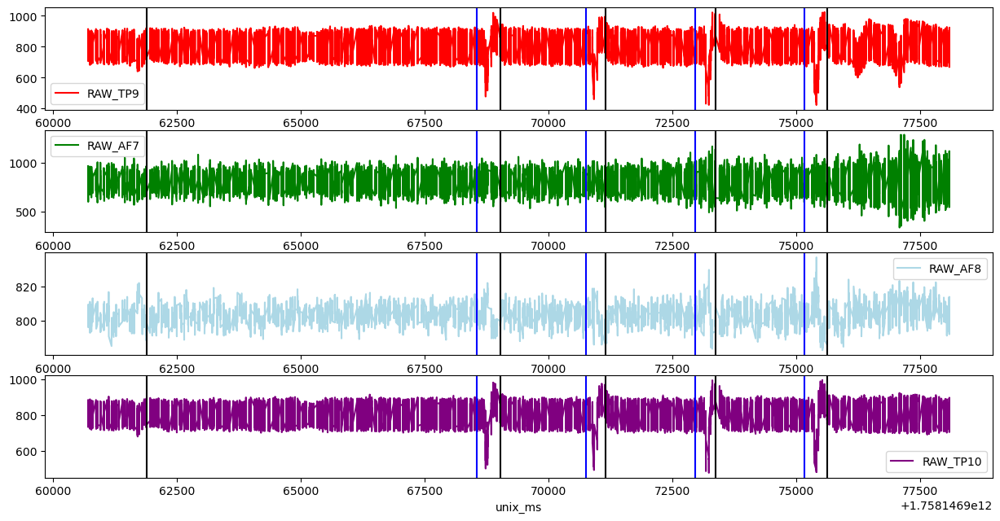

In [7]:
fig, axes = plt.subplots(4,1,figsize=(15,7.5))

# Raw EEG
eeg_raw.plot(x='unix_ms', y='RAW_TP9', c='red', ax=axes[0])
eeg_raw.plot(x='unix_ms', y='RAW_AF7', c='green', ax=axes[1])
eeg_raw.plot(x='unix_ms', y='RAW_AF8', c='lightblue', ax=axes[2])
eeg_raw.plot(x='unix_ms', y='RAW_TP10', c='purple', ax=axes[3])

# Blinks from EEG
for xc in eeg_blinks['unix_ms'].tolist():
    for i in range(0, 4):
        axes[i].axvline(x=xc, color='black', linestyle='-')
        
# Blinks from VR
vr_blink_samples = blink_df[blink_df['event']=='Overlap']
for xc in vr_blink_samples['unix_ms'].tolist():
    for i in range(0, 4):
        axes[i].axvline(x=xc, color='blue', linestyle='-')

plt.show()

## Frequency Analysis

In [26]:
from scipy.signal import get_window
import plotly.graph_objects as go

In [27]:
# Primitives for Frequency Analysis
_BANDS = { "delta": (0.5, 4), "theta": (4, 8), "alpha": (8, 13), "beta": (13, 30), "gamma": (30, 200) }
_BAND_NAMES = list(_BANDS.keys())

In [29]:
# Preprocessing EEG
def read_muse(filename):
    # Read the raw eeg file
    df = pd.read_csv(filename)
    
    # Extract seconds from unix
    df['unix_sec'] = df['TimeStamp'].apply(timestamp_to_unix_seconds)
    df['unix_ms'] = df['TimeStamp'].apply(timestamp_to_unix_milliseconds)
    
    # Calculate relative seconds
    df['rel_sec'] = df['unix_sec'] - df['unix_sec'].iloc[0]
    df['rel_ms'] = df['unix_ms'] - df['unix_ms'].iloc[0]
    
    # separate blinks from raw data
    signals = df[df['Elements'].isna()]
    blinks = df[df['Elements']=='/muse/elements/blink']
    
    # Return blinks and signals
    return signals, blinks

def clean_eeg(df):
    # Removing unecessary columns
    cleaned_df = df.drop(columns=[
        'Delta_TP9','Delta_TP10','Delta_AF7','Delta_AF8',
        'Theta_TP9', 'Theta_TP10', 'Theta_AF7', 'Theta_AF8',
        'Alpha_TP9', 'Alpha_TP10', 'Alpha_AF7', 'Alpha_AF8',
        'Beta_TP9', 'Beta_TP10', 'Beta_AF7', 'Beta_AF8',
        'Gamma_TP9', 'Gamma_TP10', 'Gamma_AF7', 'Gamma_AF8',
        'HSI_TP9','HSI_TP10', 'HSI_AF7', 'HSI_AF8',
        'AUX_LEFT', 'AUX_RIGHT',
        'Accelerometer_X', 'Accelerometer_Y', 'Accelerometer_Z',
        'Gyro_X', 'Gyro_Y', 'Gyro_Z',
        'PPG_Ambient', 'PPG_IR', "PPG_Red",
        'TimeStamp', 'HeadBandOn', 'Heart_Rate','Battery','Elements'
    ])
    cleaned_df.rename(columns={'RAW_TP9':'TP9', 'RAW_TP10':'TP10', 'RAW_AF7':'AF7', 'RAW_AF8':'AF8'}, inplace=True)
    return cleaned_df

eeg_signals, eeg_blinks = read_muse(os.path.join(_DATA_DIR, _EEG_CSV))
eeg_clean = clean_eeg(eeg_signals)
eeg_clean.head(10)
#eeg_data = eeg_clean[['TP9','TP10','AF7','AF8']].to_numpy().T  # shape (channels, samples)

,TP9,AF7,AF8,TP10,unix_sec,unix_ms,rel_sec,rel_ms
1,810.69600,892.08790,800.62270,792.16120,1.758147e+09,1758146960702,0.005,5
2,913.84610,959.37730,806.66670,884.43225,1.758147e+09,1758146960702,0.005,5
3,813.91943,759.92676,805.45790,827.61900,1.758147e+09,1758146960703,0.006,6
4,705.53110,737.36260,801.83150,732.52747,1.758147e+09,1758146960704,0.007,7
5,785.71430,926.33700,801.83150,774.02930,1.758147e+09,1758146960704,0.007,7
6,908.60803,965.42126,806.26373,871.53845,1.758147e+09,1758146960704,0.007,7
7,847.36260,762.74725,809.48720,856.22710,1.758147e+09,1758146960705,0.008,8
8,710.36630,599.15753,802.23444,754.28570,1.758147e+09,1758146960705,0.008,8
9,739.37730,813.11350,796.19050,746.22710,1.758147e+09,1758146960706,0.009,9
10,879.59705,883.62640,801.42860,845.75090,1.758147e+09,1758146960707,0.010,10


## Potential Solution 1

In [28]:
def compute_psd(df, fs=220, window_size=256, step_size=22):
    """
    Compute PSD for EEG channels AF7, AF8, TP9, TP10 using sliding FFT windows.
    
    df: pandas DataFrame with columns ['AF7', 'AF8', 'TP9', 'TP10']
    fs: sampling frequency (Hz)
    window_size: number of samples per FFT window
    step_size: hop size between windows (samples)
    
    Returns: dict with 'freqs', 'times', and 'psd' (3D array: time x freq x channel)
    """
    channels = ['AF7', 'AF8', 'TP9', 'TP10']
    n_channels = len(channels)

    # Hamming window
    window = get_window('hamming', window_size)

    # Frequency bins
    freqs = np.fft.rfftfreq(window_size, 1/fs)
    
    psd_list = []
    times = []
    
    for start in range(0, len(df) - window_size, step_size):
        segment = df.iloc[start:start+window_size][channels].values * window[:, None]
        fft_vals = np.fft.rfft(segment, axis=0)
        psd = (np.abs(fft_vals) ** 2) / (fs * window_size)
        
        psd_list.append(psd.T)  # shape: (channels, freqs)
        times.append(start / fs)
    
    psd_array = np.stack(psd_list, axis=0)  # shape: (time, channels, freqs)
    
    return {
        'freqs': freqs,
        'times': np.array(times),
        'psd': psd_array
    }

def plot_psd_interactive(result, channel='AF7'):
    """
    Plot interactive heatmap of PSD over time for a given channel.
    """
    channels = ['AF7', 'AF8', 'TP9', 'TP10']
    ch_idx = channels.index(channel)
    
    psd = result['psd'][:, ch_idx, :]
    
    fig = go.Figure(
        data=go.Heatmap(
            z=10*np.log10(psd + 1e-12),  # convert to dB
            x=result['times'],
            y=result['freqs'],
            colorscale='Viridis'
        )
    )
    
    fig.update_layout(
        title=f"PSD over Time - {channel}",
        xaxis_title="Time (s)",
        yaxis_title="Frequency (Hz)"
    )
    
    return fig

In [30]:
result = compute_psd(eeg_clean)

In [35]:
plot_psd_interactive(result, channel='AF7').show()
plot_psd_interactive(result, channel='AF8').show()
plot_psd_interactive(result, channel='TP9').show()
plot_psd_interactive(result, channel='TP10').show()

## Potential Solution 2

In [36]:
from scipy.signal import spectrogram, get_window
import plotly.subplots as sp
import plotly.graph_objects as go

In [48]:
def plot_muse_psd(df, fs=220, window_size=256, step_size=22):
    """
    Generate interactive PSD (spectrogram-style) plots for Muse EEG channels.
    
    Parameters
    ----------
    df : pandas.DataFrame
        Must contain columns: ['AF7', 'AF8', 'TP9', 'TP10'] with raw EEG samples.
    fs : int
        Sampling frequency (Hz), default = 220 for Muse.
    window_size : int
        Window length in samples for FFT (default 256).
    step_size : int
        Hop length (default 22 for 10 Hz PSD updates).
    """

    channels = ['AF7', 'AF8', 'TP9', 'TP10']
    fig = sp.make_subplots(rows=2, cols=2, subplot_titles=channels)

    # Define Hamming window
    win = get_window('hamming', window_size)

    for i, ch in enumerate(channels):
        # Spectrogram
        f, t, Sxx = spectrogram(
            df[ch].values,
            fs=fs,
            window=win,
            nperseg=window_size,
            noverlap=window_size - step_size,
            scaling='density',
            mode='psd'
        )

        # Convert to dB
        Sxx_dB = 10 * np.log10(Sxx + 1e-12)

        # Add as heatmap
        heatmap = go.Heatmap(
            z=Sxx_dB,
            x=t,
            y=f,
            colorscale='Viridis',
            colorbar=dict(title='Power (dB)'),
            zmin=-40, zmax=20
        )

        # Position subplot
        row, col = divmod(i, 2)
        fig.add_trace(heatmap, row=row+1, col=col+1)
        fig.update_yaxes(title_text="Freq (Hz)", row=row+1, col=col+1)
        fig.update_xaxes(title_text="Time (s)", row=row+1, col=col+1)

    fig.update_layout(
        title="Muse EEG Power Spectral Density (PSD)",
        height=900,
        width=1000,
    )

    fig.show()

In [49]:
plot_muse_psd(eeg_clean)

## Potential Solution 3

In [40]:
def plot_muse_psd(df, fs=220, window_size=256, overlap=0.9):
    """
    df: pandas DataFrame with columns ['AF7','AF8','TP9','TP10']
    fs: sampling rate (Hz)
    window_size: samples per FFT window
    overlap: fraction overlap between windows
    """
    n_overlap = int(window_size * overlap)
    electrodes = df.columns
    
    fig = sp.make_subplots(rows=len(electrodes), cols=1,
                           shared_xaxes=True,
                           subplot_titles=electrodes)
    
    for i, ch in enumerate(electrodes, 1):
        sig = df[ch].values
        f, t, Sxx = spectrogram(
            sig,
            fs=fs,
            window=get_window("hamming", window_size),
            nperseg=window_size,
            noverlap=n_overlap,
            detrend=False,
            scaling='density',
            mode='psd'
        )
        
        # Convert to dB
        Sxx_dB = 10 * np.log10(Sxx + 1e-12)
        
        # Plot
        fig.add_trace(
            go.Heatmap(
                x=t,
                y=f,
                z=Sxx_dB,
                colorscale='Viridis',
                colorbar=dict(title="dB", x=1.05 if i==2 else None),
            ),
            row=i, col=1
        )
    
    fig.update_layout(
        height=300*len(electrodes),
        width=800,
        title="Muse EEG Power Spectral Density (PSD)"
    )
    fig.update_yaxes(title_text="Frequency (Hz)")
    fig.update_xaxes(title_text="Time (s)")
    fig.show()

In [41]:
plot_muse_psd(eeg_clean)

## Potential Solution 4

In [51]:
def compute_muse_psd(df, fs=220, window_size=256, step_size=22):
    """
    Compute PSD frames for Muse EEG channels.

    Parameters
    ----------
    df : pandas.DataFrame
        Columns must include ['AF7', 'AF8', 'TP9', 'TP10'].
    fs : int
        Sampling frequency (Hz), default 220.
    window_size : int
        Window length in samples, default 256.
    step_size : int
        Hop length in samples, default 22.

    Returns
    -------
    psd_results : dict
        {
          'frequencies': np.array of frequency bins,
          'times': np.array of time bins,
          'psd': dict of {channel: 2D array [freqs x times]}
        }
    """
    channels = ['AF7', 'AF8', 'TP9', 'TP10']
    win = get_window('hamming', window_size)

    psd = {}
    freqs = None
    times = None

    for ch in channels:
        f, t, Sxx = spectrogram(
            df[ch].values,
            fs=fs,
            window=win,
            nperseg=window_size,
            noverlap=window_size - step_size,
            scaling='density',
            mode='psd'
        )
        Sxx_dB = 10 * np.log10(Sxx + 1e-12)  # Convert to dB
        psd[ch] = Sxx_dB
        if freqs is None:
            freqs = f
            times = t

    return {
        'frequencies': freqs,
        'times': times,
        'psd': psd
    }

In [52]:
import plotly.subplots as sp
import plotly.graph_objects as go

def plot_muse_psd(psd_results):
    """
    Plot interactive PSD heatmaps from precomputed results.

    Parameters
    ----------
    psd_results : dict
        Output of compute_muse_psd().
    """
    freqs = psd_results['frequencies']
    times = psd_results['times']
    psd = psd_results['psd']
    channels = list(psd.keys())

    fig = sp.make_subplots(rows=2, cols=2, subplot_titles=channels)

    for i, ch in enumerate(channels):
        heatmap = go.Heatmap(
            z=psd[ch],
            x=times,
            y=freqs,
            colorscale='Viridis',
            colorbar=dict(title='Power (dB)'),
            zmin=-40, zmax=20
        )
        row, col = divmod(i, 2)
        fig.add_trace(heatmap, row=row+1, col=col+1)
        fig.update_yaxes(title_text="Freq (Hz)", row=row+1, col=col+1)
        fig.update_xaxes(title_text="Time (s)", row=row+1, col=col+1)

    fig.update_layout(
        title="Muse EEG Power Spectral Density (PSD)",
        height=900,
        width=1000
    )

    fig.show()

In [55]:
# Compute PSD once
psd_data = compute_muse_psd(eeg_clean)

# Plot it separately
plot_muse_psd(psd_data)

In [58]:
def compute_bandpowers_time_series(psd_results, bands=None):
    """
    Compute absolute band power time series for each channel and frequency band.

    Parameters
    ----------
    psd_results : dict
        Output of compute_muse_psd(), containing 'frequencies', 'times', and 'psd'.
    bands : dict, optional
        Dictionary of frequency bands, e.g.
        {
            "delta": (1, 4),
            "theta": (4, 8),
            "alpha": (9, 13),
            "beta": (13, 30),
            "gamma": (30, 44)
        }

    Returns
    -------
    bandpowers : pandas.DataFrame
        MultiIndex DataFrame with (time, channel, band) → bandpower (log scale).
        Shape = (n_times × n_channels × n_bands).
    """
    if bands is None:
        bands = {
            "delta": (1, 4),
            "theta": (4, 8),
            "alpha": (9, 13),
            "beta": (13, 30),
            "gamma": (30, 44)
        }

    freqs = psd_results['frequencies']
    times = psd_results['times']
    psd = psd_results['psd']  # dict {channel: 2D array [freqs x times]}

    records = []
    for ch, Sxx_dB in psd.items():
        # Convert back from dB to linear scale
        Sxx_linear = 10 ** (Sxx_dB / 10)

        for band, (fmin, fmax) in bands.items():
            idx = np.where((freqs >= fmin) & (freqs <= fmax))[0]

            if len(idx) == 0:
                continue

            # Sum across frequency bins, keep per-time-frame values
            band_power = np.sum(Sxx_linear[idx, :], axis=0)

            # Logarithm → absolute band power
            band_power_log = np.log10(band_power + 1e-12)

            for t, val in zip(times, band_power_log):
                records.append((t, ch, band, val))

    bandpowers = pd.DataFrame(records, columns=["time", "channel", "band", "power"])
    return bandpowers

In [59]:
bandpowers = compute_bandpowers_time_series(psd_data)

In [60]:
import plotly.express as px

def plot_bandpowers_time_series(bandpowers_df):
    """
    Plot absolute band power time series.

    Parameters
    ----------
    bandpowers_df : pandas.DataFrame
        Output of compute_bandpowers_time_series().
        Must have columns ["time", "channel", "band", "power"].
    """
    fig = px.line(
        bandpowers_df,
        x="time", y="power",
        color="band",
        facet_col="channel",
        facet_col_wrap=2,
        labels={"power": "Abs. Band Power (Bels)", "time": "Time (s)"},
        title="Time-resolved Absolute Band Power"
    )
    fig.update_yaxes(matches=None)  # allow each subplot its own scale
    fig.show()

In [61]:
plot_bandpowers_time_series(bandpowers)

In [62]:
from scipy.signal import find_peaks, medfilt

def event_avg_psd_and_diff(psd_results, start_time, end_time, channels=None,
                           baseline_window=None, use_ratio=True, smooth_kernel=3):
    """
    Compute event-averaged PSD and (optionally) baseline-averaged PSD and return
    a difference (event - baseline) or ratio (event / baseline) spectrum.

    Parameters
    ----------
    psd_results : dict
        Output of compute_muse_psd(); keys: 'frequencies', 'times', 'psd' (dict per channel)
    start_time, end_time : floats
        Event interval in seconds (these align to psd_results['times'])
    channels : list or None
        Which channels to average across (default all channels present)
    baseline_window : tuple (t0, t1) or None
        If provided, used as baseline PSD. If None, uses median across entire recording.
    use_ratio : bool
        If True returns ratio (event/baseline). Else returns difference (event - baseline).
    smooth_kernel : int
        Kernel size for median smoothing of PSD (odd integer). Helps reduce spurious peaks.

    Returns
    -------
    freqs : np.array
    event_psd_mean : np.array  # averaged across time frames and channels
    baseline_psd_mean : np.array
    metric : np.array  # ratio or difference ready for peak-picking
    """
    freqs = psd_results['frequencies']
    times = psd_results['times']
    psd_dict = psd_results['psd']

    if channels is None:
        channels = list(psd_dict.keys())

    # select time indices for event
    t_idx_event = np.where((times >= start_time) & (times <= end_time))[0]
    if t_idx_event.size == 0:
        raise ValueError("No PSD frames inside event interval. Check start_time/end_time vs psd times.")

    # average PSD across chosen channels and across event time frames
    event_psd_list = []
    for ch in channels:
        S = psd_dict[ch]  # shape freqs x times
        event_psd_list.append(np.mean(S[:, t_idx_event], axis=1))  # per-channel averaged over event frames
    event_psd_mean = np.mean(np.vstack(event_psd_list), axis=0)  # avg across channels

    # baseline
    if baseline_window is not None:
        t0, t1 = baseline_window
        t_idx_base = np.where((times >= t0) & (times <= t1))[0]
        if t_idx_base.size == 0:
            raise ValueError("No PSD frames inside baseline window.")
        base_list = []
        for ch in channels:
            S = psd_dict[ch]
            base_list.append(np.mean(S[:, t_idx_base], axis=1))
        baseline_psd_mean = np.mean(np.vstack(base_list), axis=0)
    else:
        # fallback: use median across all times as baseline (robust)
        base_list = []
        for ch in channels:
            S = psd_dict[ch]
            base_list.append(np.median(S, axis=1))
        baseline_psd_mean = np.mean(np.vstack(base_list), axis=0)

    # smoothing (median filter) to reduce small fluctuations that cause false peaks
    if smooth_kernel is not None and smooth_kernel > 1:
        # medfilt requires odd kernel
        k = int(smooth_kernel) if int(smooth_kernel) % 2 == 1 else int(smooth_kernel) + 1
        event_psd_s = medfilt(event_psd_mean, kernel_size=k)
        baseline_psd_s = medfilt(baseline_psd_mean, kernel_size=k)
    else:
        event_psd_s = event_psd_mean
        baseline_psd_s = baseline_psd_mean

    # produce metric for peak finding
    if use_ratio:
        # avoid division by zero; operate in linear power (psd likely in dB, convert first)
        # If psd_results stores dB, convert back to linear:
        # If values are already linear, skip conversion. We'll assume PSD is in dB (per earlier pipeline)
        event_lin = 10 ** (event_psd_s / 10)
        base_lin = 10 ** (baseline_psd_s / 10)
        metric = event_lin / (base_lin + 1e-12)
    else:
        # difference in linear or dB? To highlight relative increase, difference of linear is better.
        event_lin = 10 ** (event_psd_s / 10)
        base_lin = 10 ** (baseline_psd_s / 10)
        metric = event_lin - base_lin

    return freqs, event_psd_s, baseline_psd_s, metric

In [63]:
def identify_dominant_frequencies(freqs, metric, n_peaks=1, min_prominence=1.5, min_distance_hz=1.0):
    """
    Identify prominent peaks in the metric (ratio or difference).

    Parameters
    ----------
    freqs : array
    metric : array (same length as freqs)
    n_peaks : int number of peaks to return
    min_prominence : float
        Minimum prominence in metric units (e.g., ratio > 1.5 means 50% increase).
    min_distance_hz : float
        Minimum separation between peaks in Hz.

    Returns
    -------
    peaks : list of (f0, metric_value, peak_index)
    """
    # convert min_distance_hz to samples
    df = np.mean(np.diff(freqs))
    distance_samples = max(1, int(np.round(min_distance_hz / df)))

    # Use find_peaks
    peak_idx, props = find_peaks(metric, prominence=min_prominence, distance=distance_samples)
    prominences = props.get('prominences', None)

    # if no peaks found, try relaxing prominence slightly
    if peak_idx.size == 0:
        peak_idx, props = find_peaks(metric, distance=distance_samples)
        prominences = props.get('prominences', None)

    # collect peaks and sort by metric value (desc)
    peak_entries = []
    for idx in peak_idx:
        peak_entries.append((freqs[idx], float(metric[idx]), int(idx)))

    peak_entries.sort(key=lambda x: x[1], reverse=True)
    return peak_entries[:n_peaks]

In [64]:
start_time, end_time = 8.0, 10.0
freqs, event_psd, baseline_psd, metric = event_avg_psd_and_diff(
    psd_data, start_time, end_time, 
    channels=['AF7','AF8','TP9','TP10'], 
    use_ratio=True
)
peaks = identify_dominant_frequencies(
    freqs, 
    metric, 
    n_peaks=2, 
    min_prominence=1.5, 
)

In [65]:
peaks

[(1.71875, 3.0856802074918663, 2)]

In [10]:
def psd(signal, sample_rate):
    # Calculate power spectral density via welch's method
    f, Pxx = welch(signal, fs=sample_rate, nperseg=fs*2) 
    # Calculate band powers for each frequency band
    band_powers = {}
    for band, (low, high) in _BANDS.items():
        idx = np.logical_and(f >= low, f <= high)
        # band_powers[band] = np.mean(Pxx[idx]) ## Mean spectral density
        band_powers[band] = np.trapz(Pxx[idx], f[idx])
    print(band_powers)

In [12]:
def band_power(psd, freqs, bands):
    """
    Compute absolute band powers (linear scale).
    
    Args:
        psd (1D array): PSD values (per FFT frame)
        freqs (1D array): Frequency bins corresponding to PSD
        bands (dict): e.g. {"alpha": (9, 13), "beta": (13, 30)}
    
    Returns:
        dict: band power per frequency band
    """
    
    results = {}
    for name, (low, high) in bands.items():
        idx = np.logical_and(freqs >= low, freqs <= high)
        results[name] = np.sum(psd[idx])   # absolute band power
    return results

In [13]:
def compute_muse_fft(eeg_signal, window, fs=220):
    """
    Compute PSD values in Muse-style FFT pipeline.

    Args:
        eeg_signal (1D np.array): EEG samples for one channel
        fs (int): Sampling frequency, default 220 Hz

    Returns:
        psd_frames: list of arrays (each array is 129 PSD values for one frame)
        freqs: frequency bins (0–110 Hz, 129 values)
    """

    # Pre-compute FFT frequency bins
    freqs = np.fft.rfftfreq(win_size, 1/fs)[:129]  # 0–110Hz, 129 bins

    psd_frames = []

    # Sliding window loop
    for start in range(0, len(eeg_signal) - win_size, hop_size):
        segment = eeg_signal[start:start+win_size]

        # Apply window
        segment_win = segment * window

        # FFT
        fft_vals = np.fft.rfft(segment_win)

        # Power spectral density
        psd = (np.abs(fft_vals) ** 2) / (fs * np.sum(window**2))

        # Keep first 129 bins
        psd_frames.append(psd[:129])

    return np.array(psd_frames), freqs

In [ ]:
def muse_bandpowers(eeg_data, fs=220):
    """
    Compute Muse-style absolute band powers from EEG data.
    
    Args:
        eeg_data (2D np.array): shape (channels, samples)
        fs (int): Sampling frequency, default 220 Hz
        
    Returns:
        bandpower_frames: np.array shape (frames, channels, bands)
        freqs: frequency bins (0–110 Hz, 129 bins)
        band_names: list of band names in output order
    """
    
    # FFT setup
    win_size = 256
    hop_size = 22
    window = hamming(win_size, sym=False)
    freqs = np.fft.rfftfreq(win_size, 1/fs)[:129]  # 0–110 Hz, 129 bins
    
    # EEG bands
    bands = {
        "delta": (1, 4),
        "theta": (4, 8),
        "alpha": (9, 13),
        "beta": (13, 30),
        "gamma": (30, 45)
    }
    band_names = list(bands.keys())
    
    # Precompute indices for each band
    band_idx = {
        name: np.logical_and(freqs >= low, freqs <= high)
        for name, (low, high) in bands.items()
    }
    
    frames = []
    
    # Loop over sliding windows
    for start in range(0, eeg_data.shape[1] - win_size, hop_size):
        frame_results = []
        
        # Each channel
        for ch in range(eeg_data.shape[0]):
            segment = eeg_data[ch, start:start+win_size]
            segment_win = segment * window
            
            # FFT → PSD
            fft_vals = np.fft.rfft(segment_win)
            psd = (np.abs(fft_vals) ** 2) / (fs * np.sum(window**2))
            psd = psd[:129]  # restrict to 0–110 Hz
            
            # Band powers
            band_powers = [np.sum(psd[idx]) for idx in band_idx.values()]
            frame_results.append(band_powers)
        
        frames.append(frame_results)
    
    return np.array(frames), freqs, band_names

# Wrapping it all with Muse

## EEG Preprocessing

## Muse Operations

In [20]:
def muse_bandpowers(eeg_data, window_size=256, hop_size=22, fs=220):
    """
    Compute Muse-style absolute band powers from EEG data.
    
    Args:
        eeg_data (2D np.array): shape (channels, samples)
        fs (int): Sampling frequency, default 220 Hz
        
    Returns:
        bandpower_frames: np.array shape (frames, channels, bands)
        freqs: frequency bins (0–110 Hz, 129 bins)
        band_names: list of band names in output order
    """
    
    # FFT setup
    window = hamming(window_size, sym=False)
    freqs = np.fft.rfftfreq(window_size, 1/fs)[:129]  # 0–110 Hz, 129 bins
    
    # Precompute indices for each EEG band
    band_idx = {
        name: np.logical_and(freqs >= low, freqs <= high)
        for name, (low, high) in bands.items()
    }
    
    frames = []
    
    # Loop over sliding windows
    for start in range(0, eeg_data.shape[1] - window_size, hop_size):
        frame_results = []
        
        # Each channel
        for ch in range(eeg_data.shape[0]):
            segment = eeg_data[ch, start:start+window_size]
            segment_win = segment * window
            
            # FFT → PSD
            fft_vals = np.fft.rfft(segment_win)
            psd = (np.abs(fft_vals) ** 2) / (fs * np.sum(window**2))
            psd = psd[:129]  # restrict to 0–110 Hz
            
            # Band powers
            band_powers = [np.sum(psd[idx]) for idx in band_idx.values()]
            frame_results.append(band_powers)
        
        frames.append(frame_results)
    
    return np.array(frames), freqs, band_names

bandpower_frames, freqs, band_names = muse_bandpowers(eeg_data)

In [21]:
# bandpower_frames: shape = (frames, channels, bands) 
#      → e.g. (50, 2, 5) for 50 frames, 2 channels, 5 bands.
# band_names: ["delta", "theta", "alpha", "beta", "gamma"]
# freqs: the FFT bin frequencies (0–110 Hz).

print(bandpower_frames.shape)  # (num_frames, channels, bands). 
# Note that electrodes and frequency bands operate in the order supplied
# So in this case, for channels, ['TP9','TP10','AF7','AF8'] is their order.
print("Bands:", band_names)
print("Frame 0, channel 0:", bandpower_frames[0,0])

(192, 4, 5)
Bands: ['delta', 'theta', 'alpha', 'beta', 'gamma']
Frame 0, channel 0: [9.82864389e+04 1.68313196e+01 6.07700817e+00 1.02074596e+01
 3.33284385e+03]


In [22]:
def plot_bandpowers(bandpower_frames, band_names, channel_names, hop_size=22, fs=220):
    """
    Superplot: subplots for each channel (rows) × band (columns).
    
    Args:
        bandpower_frames (np.array): shape (frames, channels, bands)
        band_names (list): e.g. ["delta", "theta", "alpha", "beta", "gamma"]
        channel_names (list): e.g. ["TP9", "TP10", "AF7", "AF8"]
        hop_size (int): samples advanced per frame (default = 22)
        fs (int): sampling frequency in Hz (default = 220)
    """
    n_frames, n_channels, n_bands = bandpower_frames.shape
    
    # Compute time axis in seconds (one point per frame)
    frame_times = np.arange(n_frames) * (hop_size / fs)

    fig, axes = plt.subplots(n_channels, n_bands, 
                             figsize=(4*n_bands, 3*n_channels), 
                             sharex=True)
    
    # If only 1D, axes may not be a 2D array
    if n_channels == 1:
        axes = axes[np.newaxis, :]
    if n_bands == 1:
        axes = axes[:, np.newaxis]
    
    # Plot each channel × band
    for ch in range(n_channels):
        for b in range(n_bands):
            ax = axes[ch, b]
            ax.plot(frame_times, bandpower_frames[:, ch, b])
            ax.set_title(f"{channel_names[ch]} - {band_names[b]}")
            ax.set_xlabel("Time (s)")
            ax.set_ylabel("Power")
    
    plt.tight_layout()
    plt.show()

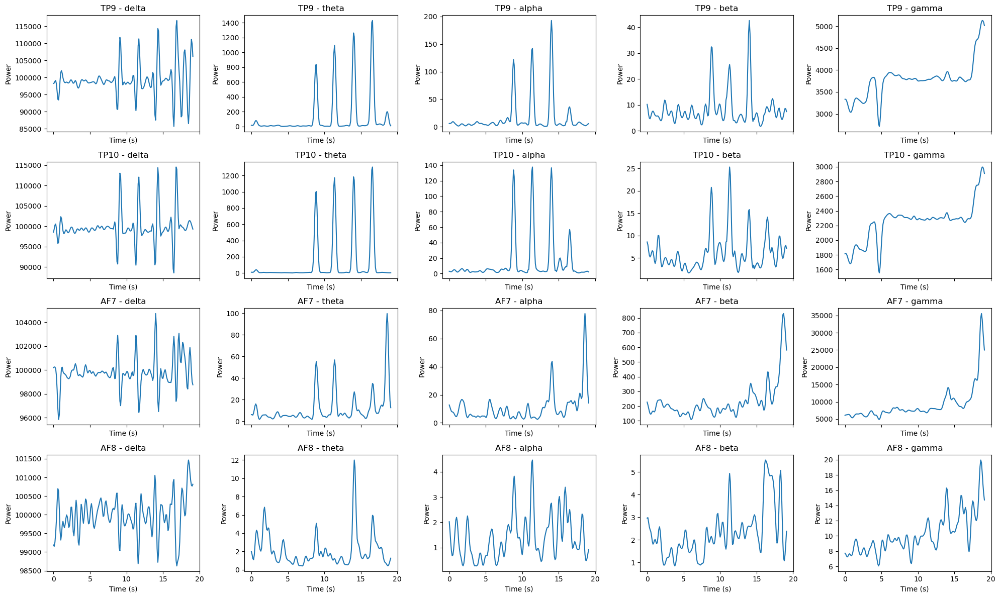

In [23]:
channel_names = ['TP9','TP10','AF7','AF8']
plot_bandpowers(bandpower_frames, band_names, channel_names)